<a id='Q0'></a>
</a> </center>
<center> <h1> Customer Segmentation using Pycaret </h1> </center>
<p style="margin-bottom:1cm;"></p>
<center><h4>ML Project, 2022, by Marlies Monch and Sibel Yasemin Özgan</h4></center>
<p style="margin-bottom:1cm;"></p>

<div style="background:#EEEDF5;border-top:0.1cm solid #EF475B;border-bottom:0.1cm solid #EF475B;">
    <div style="margin-left: 0.5cm;margin-top: 0.5cm;margin-bottom: 0.5cm;color:#303030">
        <p><strong>Goal:</strong> This is a project to find out the most useful customer segmentation to improve the marketing campaigns of the credit card company.</p>
        <strong> Outline:</strong>
        <a id='P0' name="P0"></a>
        <ol>
            <li> <a style="color:#303030" href='#I'>Introduction </a> </li>
            <li> <a style="color:#303030" href='#SU'>Set up</a></li>
            <li> <a style="color:#303030" href='#P1'>Part 1</a></li>
            <li> <a style="color:#303030" href='#P2'>Part 2</a></li>
            <li> <a style="color:#303030" href='#P3'>Part 3</a></li>
            <li> <a style="color:#303030" href='#CL'>Conclusion</a></li>
        </ol>
        <strong>Keywords:</strong> data cleaning, exploratory data analysis, customer segmentation, clustering.
    </div>
</div>
</nav>

<div style="background:#EEEDF5;color:#303030"><div style="margin-left: .2cm">
    <b>Comments:</b>
</div></div>

<div style="margin-left: 0.4cm">
    This Markdown cell is a template to write extended comments. e.g. explain the approach taken, or concepts behind algorithm chosen. Aim at having 2 lines at least. Anything smaller can be directly integrated in the code, or gathered together with other comments to form a bigger paragraph. Since this block is within a div element, you need to use html formatting syntax, not markdown
</div>

<div style="background:#EEEDF5;border:0.1cm solid #FDB100;color:#303030">
    <div style="margin: 0.2cm 0.2cm 0.2cm 0.2cm">
        <b style="color:#FDB100">Title:</b> 
        This is a an example yellow box
    </div>
</div>

<div style="background:#EEEDF5;border:0.1cm solid #00BAE5;color:#303030">
    <div style="margin: 0.2cm 0.2cm 0.2cm 0.2cm">
        <b style="color:#00BAE5">Note:</b>
        This is an example Blue Box
    </div>
</div>

<div style="background:#EEEDF5;border:0.1cm solid #EF475B;color:#303030">
    <div style="margin: 0.2cm 0.2cm 0.2cm 0.2cm">
        <b style="color:#EF475B">Warning:</b> 
        This is an example red box
    </div>
</div>

<a id='I' name="I"></a>
## [Introduction](#P0)

The credit card transaction dataset contains 8500 customers and their activity over a 6-month period. Each transaction is characterized by 18 features described below.

The features:

* customer_id : id of the credit card holder

* balance_account : balance amount left in the account to make purchases at the end of the 6-month period

* purchases_amount : amount of purchases made from account

* paid_advance : number of transactions made with “Cash in Advance” method

* full_purchases : maximum purchase amount done in full payment

* balance_frequency_update : how frequently the balance has been updated, score between 0 and 1 (1 = frequently - updated, 0 = not frequently updated)

* installments : amount of purchases done in installments

* purchases_frequency : how frequently the purchases are being made, score between 0 and 1 (1 = frequently - - purchased, 0 = not frequently purchased)

* full_purchases_frequency : how frequently purchases are happening in full payment (1 = frequently purchased, - 0 = not frequently purchased)

* purchases_installments_frequency : how frequently purchases in installments are being done (1 = frequently - done, 0 = not frequently done)

* cash_advance_frequency : how frequently the cash in advance being paid

* nr_cash_advances : cash in advance given by the user

* nr_purchases : number of purchase transactions made

* credit_limit : limit of credit card for user

* fixed_rate_period : duration of fixed interest rate of credit card service for user (in months)

* payments : amount of payment done by user

* min_payments : minimum amount of payments made by user

* full_payment_prc : percent of full payment paid by user

<a id='SU' name="SU"></a>
## [Set up](#P0)

### Magics

In [ ]:
# auto reload packages and modules when they are modified
#%load_ext autoreload
#%autoreload 2
# draw matplotlib plots in line
#%matplotlib inline
# enforce PEP 8 code on jupyter lab ...
#%load_ext lab_black
# ... or jupyter notebook
# %load_ext nb_black

### PyCaret

In [1]:
pip install pycaret[full] #==2.3.4

     |████████████████████████████████| 288 kB 6.1 MB/s 
     |████████████████████████████████| 167 kB 39.2 MB/s 
     |████████████████████████████████| 56 kB 4.5 MB/s 
     |████████████████████████████████| 113 kB 39.2 MB/s 
     |████████████████████████████████| 1.7 MB 37.8 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 6.8 MB 7.9 MB/s 
     |████████████████████████████████| 1.3 MB 14.6 MB/s 
     |████████████████████████████████| 261 kB 26.8 MB/s 
     |████████████████████████████████| 15.5 MB 503 kB/s 
     |████████████████████████████████| 86 kB 3.6 MB/s 
     |████████████████████████████████| 2.0 MB 28.4 MB/s 
     |████████████████████████████████| 40 kB 3.0 MB/s 
     |████████████████████████████████| 100 kB 7.1 MB/s 
     |████████████████████████████████| 173.5 MB 14 kB/s 
     |██████████████████████

In [1]:
!pip install pyyaml==5.4.1 --ignore-installed

     |████████████████████████████████| 636 kB 5.4 MB/s 


### Kaleido

In [2]:
pip install -U kaleido

     |████████████████████████████████| 79.9 MB 117 kB/s 


### Packages

In [3]:
# General
import pandas as pd
import numpy as np

# modelling
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer, TfidfVectorizer
from pycaret.clustering import *
#from pycaret.classification import *

# Visualization
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl

import plotly.express as px
import plotly.graph_objects as go

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


### Custom classes and functions

In [ ]:
import sys
SCRIPT_DIR = "../src"
sys.path.append(SCRIPT_DIR)

In [ ]:
from template_module import my_function_name

### Global Parameters Setting

In [4]:
plt.style.use("default")

### User-Dependent Variables

<a id='P1'></a>
## [Part one: Exploratory Data Analysis](#P0)

Below is the detailed description and analyses on the data. Visualizations show the insights gained from the dataset



### Customer Data

We use Google Colab as our environment

In [ ]:
# Load the Drive helper and mount
from google.colab import drive

# This will prompt for authorization.
drive.mount('/content/drive')

In [ ]:
# After executing the cell above, Drive
# files will be present in "/content/drive/My Drive".
!ls "/content/sample_data"

In [5]:
data = "/content/sample_data/card_transactions.csv"
df = pd.read_csv(data)

df

,customer_id,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc
0,tGEg8fT2eCgVxdwS,9.298409,107.60,0.000000,0.00,0.909091,107.60,0.909091,0.000000,0.818182,0.000000,0,10,1000.0,11,89.868853,89.711672,0.428571
1,stEDu20sSKOXomjg,52.666422,150.30,0.000000,0.00,1.000000,150.30,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,6,54.722514,82.955180,0.000000
2,CEB2blrN3b88GsRe,1360.795674,0.00,462.861443,0.00,1.000000,0.00,0.000000,0.000000,0.000000,0.272727,6,0,1500.0,11,303.031979,443.781316,0.000000
3,0N0eBl8ySaZThxKE,2021.641161,363.18,0.000000,363.18,1.000000,0.00,1.000000,1.000000,0.000000,0.000000,0,13,2000.0,12,704.240770,795.859808,0.000000
4,6NLauoHUwtwOv4Wy,22.322374,95.00,1162.045833,95.00,0.363636,0.00,0.083333,0.083333,0.000000,0.166667,3,1,2500.0,12,4094.261427,40.142262,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8495,zdVfd3CYHYBjf61b,1127.607606,0.00,271.093275,0.00,1.000000,0.00,0.000000,0.000000,0.000000,0.083333,1,0,8500.0,12,662.387331,260.277533,0.000000
8496,JGghMowcxhfbVGKm,21.409828,149.71,0.000000,0.00,1.000000,149.71,0.916667,0.000000,0.916667,0.000000,0,11,1500.0,12,141.974905,150.500248,0.166667
8497,5GrEtC6ncxuLpnXZ,0.000000,0.00,253.887233,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.111111,1,0,500.0,9,2437.932505,NaN,0.000000
8498,Ox7ETtYHjE2uo4Xo,1646.384530,1047.34,146.650389,1047.34,1.000000,0.00,0.583333,0.583333,0.000000,0.166667,2,51,3000.0,12,462.848132,497.408854,0.000000


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8500 entries, 0 to 8499
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   customer_id                       8500 non-null   object 
 1   balance_account                   8500 non-null   float64
 2   purchases_amount                  8500 non-null   float64
 3   paid_advance                      8500 non-null   float64
 4   full_purchases                    8500 non-null   float64
 5   balance_frequency_update          8500 non-null   float64
 6   installments                      8500 non-null   float64
 7   purchases_frequency               8500 non-null   float64
 8   full_purchases_frequency          8500 non-null   float64
 9   purchases_installments_frequency  8500 non-null   float64
 10  cash_advance_frequency            8500 non-null   float64
 11  nr_cash_advances                  8500 non-null   int64  
 12  nr_pur

In [7]:
df.isnull().values.any()

True

<div style="background:#EEEDF5;color:#303030"><div style="margin-left: .2cm">
    <b>Comments:</b>
</div></div>

<div style="margin-left: 0.4cm">
    There is only one row with missing values (NaN) in the credit_limit column. Since the number of rows is 8500, it is safe to drop this one column from the dataset. 
    Yet, there are a lot of missing values in the min_payments column (298 rows). Dropping those would cause a lot of valuable information to be lost. Hence, the approach should be inclusive of an imputer.
</div>

<div style="background:#EEEDF5;border:0.1cm solid #00BAE5;color:#303030">
    <div style="margin: 0.2cm 0.2cm 0.2cm 0.2cm">
   <b style="color:#00BAE5">Note:</b>
        The detailed approach for imputation and scaling is described in XXX
    </div>
</div>

In [8]:
df_clear = df.dropna(subset=['credit_limit'], how='all')
df_clear.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8499 entries, 0 to 8499
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   customer_id                       8499 non-null   object 
 1   balance_account                   8499 non-null   float64
 2   purchases_amount                  8499 non-null   float64
 3   paid_advance                      8499 non-null   float64
 4   full_purchases                    8499 non-null   float64
 5   balance_frequency_update          8499 non-null   float64
 6   installments                      8499 non-null   float64
 7   purchases_frequency               8499 non-null   float64
 8   full_purchases_frequency          8499 non-null   float64
 9   purchases_installments_frequency  8499 non-null   float64
 10  cash_advance_frequency            8499 non-null   float64
 11  nr_cash_advances                  8499 non-null   int64  
 12  nr_pur

In [9]:
df_clear = df_clear.drop(columns= "customer_id", axis=1)

df_clear.head()

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc
0,9.298409,107.60,0.000000,0.00,0.909091,107.6,0.909091,0.000000,0.818182,0.000000,0,10,1000.0,11,89.868853,89.711672,0.428571
1,52.666422,150.30,0.000000,0.00,1.000000,150.3,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,6,54.722514,82.955180,0.000000
2,1360.795674,0.00,462.861443,0.00,1.000000,0.0,0.000000,0.000000,0.000000,0.272727,6,0,1500.0,11,303.031979,443.781316,0.000000
3,2021.641161,363.18,0.000000,363.18,1.000000,0.0,1.000000,1.000000,0.000000,0.000000,0,13,2000.0,12,704.240770,795.859808,0.000000
4,22.322374,95.00,1162.045833,95.00,0.363636,0.0,0.083333,0.083333,0.000000,0.166667,3,1,2500.0,12,4094.261427,40.142262,0.000000


### Analysing Correlation between the features in the dataset

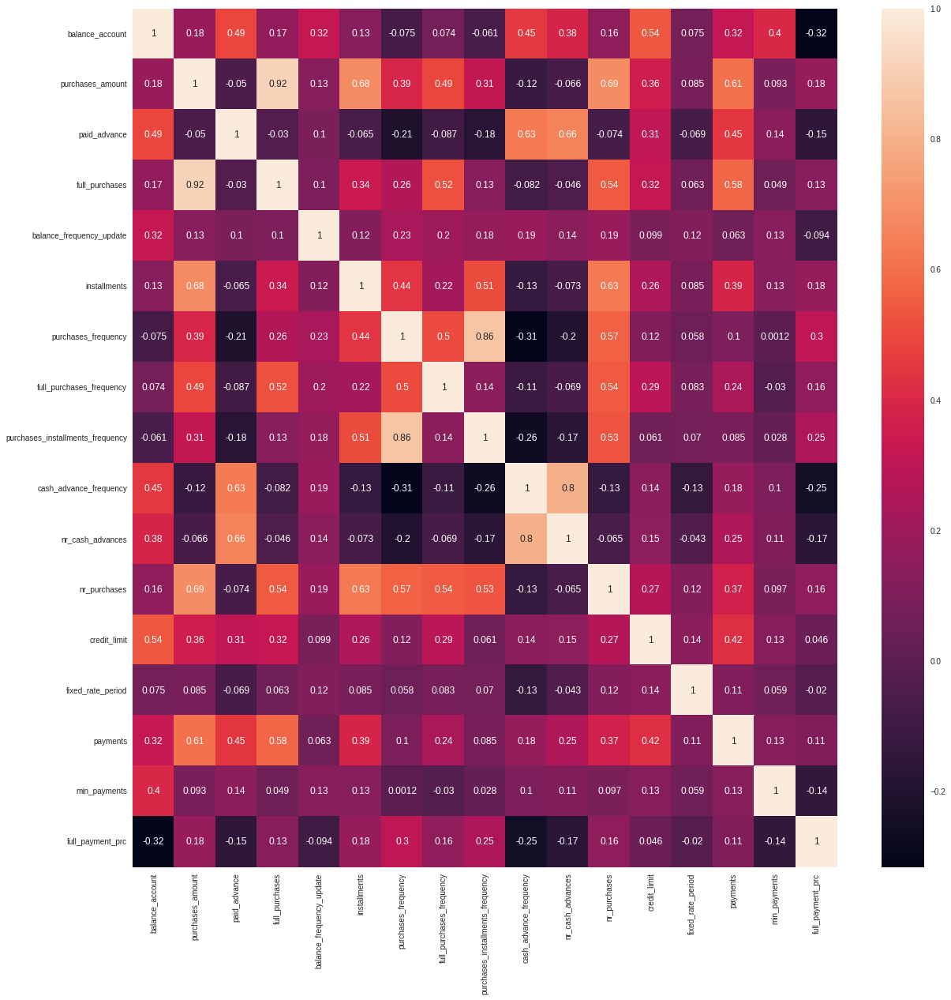

In [ ]:
cor = df_clear.corr()

plt.figure(figsize = (20,20))
sns.heatmap(cor, annot=True)
#sns.set_context("notebook", font_scale=0.5)
#sns.set_context(rc={"font.size":30,"axes.titlesize":30,"axes.labelsize":30, })
#plt.set_xticklabels(fontsize = 12)

plt.show()

<div style="background:#EEEDF5;color:#303030"><div style="margin-left: .2cm">
    <b>Comments:</b>
</div></div>

<div style="margin-left: 0.4cm">
    Seaborns heatmap() function visualizes the correlation values among the features. Whereas values that are above 0.5 show considerable correlations, the visual shows that there are features that have values more than 0.8, pointing out highly correlations.  
</div>

<Figure size 1000x5000 with 0 Axes>

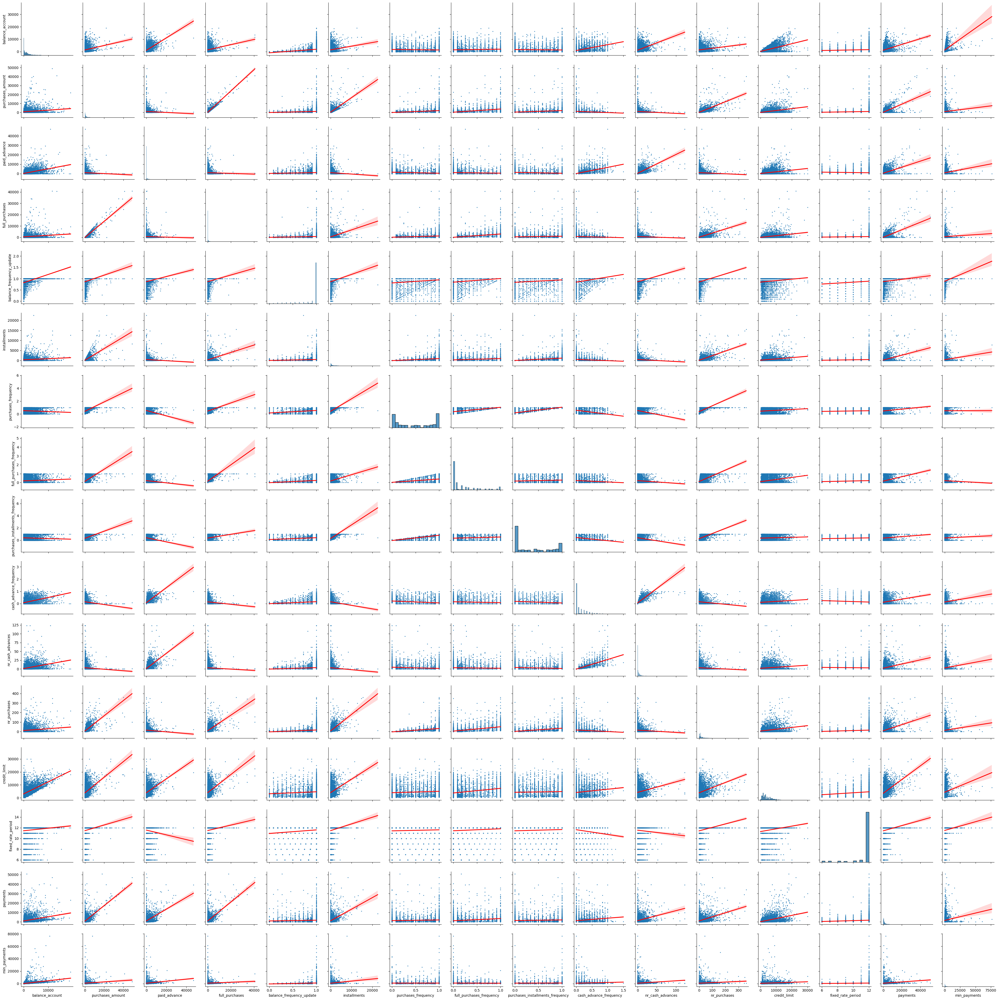

In [10]:
plt.figure(figsize = (10,50))

plot_kws = {'scatter_kws': {'s': 2}, 'line_kws': {'color': 'red'}}
sns.pairplot(df_clear, kind='reg', vars=df_clear.columns[:-1], plot_kws=plot_kws)
plt.show()

<div style="background:#EEEDF5;color:#303030"><div style="margin-left: .2cm">
    <b>Comments:</b>
</div></div>

<div style="margin-left: 0.4cm">
    Seaborns pairplot() function visualizes a scatter plot matrix for the dataset, as well as the histogram o each variable on the diagonal axes. As in the heatmap, this visualization shows strong linear relationships among some variables, highlighted by regression lines ("reg"). 
</div>

In [ ]:
df_clear.hist(bins = 30, figsize = (12,20), grid = False)
plt.show()

In [ ]:
#numerics = df_clear.columns.tolist()

In [ ]:
#numerics

['balance_account',
 'purchases_amount',
 'paid_advance',
 'full_purchases',
 'balance_frequency_update',
 'installments',
 'purchases_frequency',
 'full_purchases_frequency',
 'purchases_installments_frequency',
 'cash_advance_frequency',
 'nr_cash_advances',
 'nr_purchases',
 'credit_limit',
 'fixed_rate_period',
 'payments',
 'min_payments',
 'full_payment_prc']

<a id='P2' name="P2"></a>
## [Part 2 Customer Segmentation with PyCaret](#P0)

## Initialize the PyCaret Environment

<div style="background:#EEEDF5;color:#303030"><div style="margin-left: .2cm">
    <b>Comments:</b>
</div></div>

<div style="margin-left: 0.4cm">
    After the exploratory data analysis, we can initialize the PyCaret Environment. PyCaret has various options to develop user-defined parameters inside the model, below is an example where different options are specified. However, in this case we continue with the default settings.
</div>

In [ ]:
## PyCaret has various options to develop user-defined features inside the model, below is an example where different options are specified. 
## 
"""cluster = setup(df_clear, session_id = 7652,
                numeric_features=numerics,
                normalize=True,
                remove_multicollinearity=True,
                multicollinearity_threshold = 0.8
                )"""

In [11]:
cluster = setup(df_clear, session_id = 7652)

,Description,Value
0,session_id,7652
1,Original Data,"(8499, 17)"
2,Missing Values,True
3,Numeric Features,16
4,Categorical Features,1
5,Ordinal Features,False
6,High Cardinality Features,False
7,High Cardinality Method,None
8,Transformed Data,"(8499, 23)"
9,CPU Jobs,-1


In [12]:
model = create_model("kmeans")

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3915,2575.8881,1.3077,0,0,0


In [ ]:
model.get_params()

{'algorithm': 'auto',
 'copy_x': True,
 'init': 'k-means++',
 'max_iter': 300,
 'n_clusters': 4,
 'n_init': 10,
 'n_jobs': -1,
 'precompute_distances': 'deprecated',
 'random_state': 7652,
 'tol': 0.0001,
 'verbose': 0}

<div style="background:#EEEDF5;color:#303030"><div style="margin-left: .2cm">
    <b>Comments:</b>
</div></div>

<div style="margin-left: 0.4cm">
    create_model() function lets us to create and evaluate a clustering model of our preference, this time the K-Means algorithm. Other available options can be seen with model(). The default settings for create_model creates 4 clusters, after the execution a number of performance metrics are printed. These are Silhouette, Calinski- Harabasz and Davies-Bouldin.
    As an example the silhouette coefficient shows the performance of the model, a higher score is better.
</div>

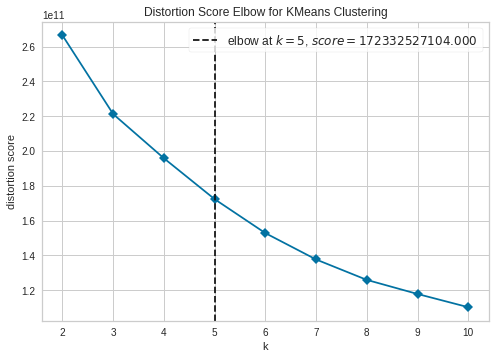

In [ ]:
plot_model(model, "elbow")

<div style="background:#EEEDF5;color:#303030"><div style="margin-left: .2cm">
    <b>Comments:</b>
</div></div>

<div style="margin-left: 0.4cm">
    Using plot_model and specifying "elbow" we can identify the best number of clusters in our model. The dashed vertical line highlights the most efficient number which is K=5. Therefore we create another model this time with 5 clusters. As expected the silhouette score for 5 clusters is better than with 4 clusters
</div>

In [13]:
model = create_model("kmeans", num_clusters = 5)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.392,2484.3643,1.2478,0,0,0


<div style="background:#EEEDF5;color:#303030"><div style="margin-left: .2cm">
    <b>Comments:</b>
</div></div>

<div style="margin-left: 0.4cm">
    We can now plot different visuals using plot_model
</div>

**Distance between centers**

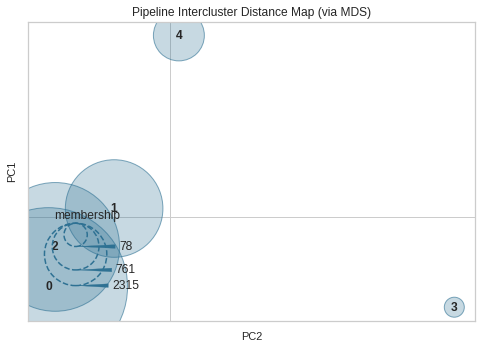

In [ ]:
plot_model(model, "distance")

**tSNE Plot for Clusters**

In [ ]:
plot_model(model, "tsne")

**2D Cluster Plot**

In [ ]:
plot_model(model, "cluster")

**Silhouette Plot**

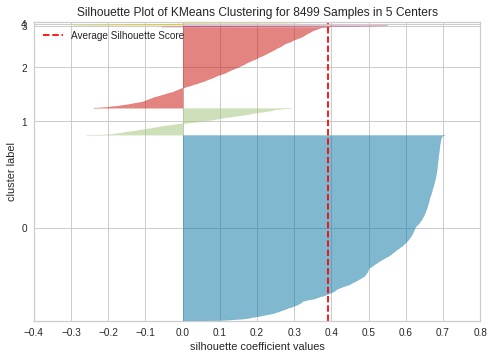

In [ ]:
plot_model(model, plot = "silhouette")

**Distribution Plot**

In [ ]:
plot_model(model, plot = "distribution")

<div style="background:#EEEDF5;color:#303030"><div style="margin-left: .2cm">
    <b>Comments:</b>
</div></div>

<div style="margin-left: 0.4cm">
    save_model function returns a new dataframe that shows the clusters for each entry in the dataframe
</div>

In [14]:
save_model(model, "clustering_model")

results = assign_model(model)
results.head(10)

Transformation Pipeline and Model Successfully Saved


,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc,Cluster
0,9.298409,107.60,0.000000,0.00,0.909091,107.6,0.909091,0.000000,0.818182,0.000000,0,10,1000.0,11,89.868853,89.711672,0.428571,Cluster 0
1,52.666422,150.30,0.000000,0.00,1.000000,150.3,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,6,54.722514,82.955180,0.000000,Cluster 0
2,1360.795674,0.00,462.861443,0.00,1.000000,0.0,0.000000,0.000000,0.000000,0.272727,6,0,1500.0,11,303.031979,443.781316,0.000000,Cluster 0
3,2021.641161,363.18,0.000000,363.18,1.000000,0.0,1.000000,1.000000,0.000000,0.000000,0,13,2000.0,12,704.240770,795.859808,0.000000,Cluster 0
4,22.322374,95.00,1162.045833,95.00,0.363636,0.0,0.083333,0.083333,0.000000,0.166667,3,1,2500.0,12,4094.261427,40.142262,0.000000,Cluster 0
5,9266.080540,100.00,4383.296268,0.00,1.000000,100.0,0.333333,0.000000,0.250000,0.166667,3,4,17500.0,12,2444.123547,2603.406476,0.000000,Cluster 1
6,97.389327,60.00,0.000000,60.00,1.000000,0.0,0.083333,0.083333,0.000000,0.000000,0,1,12500.0,12,453.421982,204.880010,0.000000,Cluster 2
7,4788.283283,0.00,437.808586,0.00,1.000000,0.0,0.000000,0.000000,0.000000,0.166667,2,0,5000.0,12,823.840717,1934.821741,0.000000,Cluster 2
8,319.037744,1262.28,0.000000,1262.28,0.818182,0.0,0.250000,0.250000,0.000000,0.000000,0,6,10500.0,12,1350.541585,218.810614,0.125000,Cluster 2
9,1641.251218,0.00,2990.165538,0.00,0.727273,0.0,0.000000,0.000000,0.000000,0.166667,4,0,3000.0,12,4399.723425,500.276155,0.142857,Cluster 0


<a id='P2' name="P2"></a>
## [Part 3 Meaningful Questions](#P0)

Now that we have Clusters and separations between our customers, we need to define why they are segmented into different groups. For that, we need to see the differences between the distribution of the features in each custer 

<a id='I' name="I"></a>
## [Features](#P0)

### Balance_Account

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[0])


### Purchases Amount

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[1])


### Paid Advance

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[2])


### Full Purchases

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[3])


### Balance Frequency Update

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[4])


### Balance Frequency Update

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[4])


### Installments

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[5])


### Purchases Frequency

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[6])


In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[7])


### Purchases Installment Frequency

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[8])


### Cash Advance Frequency

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[9])


### Nr_Cash Advance

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[10])


### Nr Purchases

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[11])


### Credit Limit

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[12])


### Fixed Rate Period

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[13])


### Payments

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[14])


### Min Payments

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[15])


### Full Payment Perc

In [ ]:
plot_model(model, plot = "distribution", feature = df_clear.columns[16])


<a id='I' name="I"></a>
## [The Distibution of Each Feature Among Clusters](#P0)

To see the different feature values as histograms, we use imputer and scaler.

In [15]:
clusters = results[["Cluster"]]
clusters

,Cluster
0,Cluster 0
1,Cluster 0
2,Cluster 0
3,Cluster 0
4,Cluster 0
...,...
8495,Cluster 2
8496,Cluster 0
8497,Cluster 0
8498,Cluster 0


In [16]:
df_c = results.drop("Cluster", axis=1)
df_c

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc
0,9.298409,107.60,0.000000,0.00,0.909091,107.60,0.909091,0.000000,0.818182,0.000000,0,10,1000.0,11,89.868853,89.711672,0.428571
1,52.666422,150.30,0.000000,0.00,1.000000,150.30,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,6,54.722514,82.955180,0.000000
2,1360.795674,0.00,462.861443,0.00,1.000000,0.00,0.000000,0.000000,0.000000,0.272727,6,0,1500.0,11,303.031979,443.781316,0.000000
3,2021.641161,363.18,0.000000,363.18,1.000000,0.00,1.000000,1.000000,0.000000,0.000000,0,13,2000.0,12,704.240770,795.859808,0.000000
4,22.322374,95.00,1162.045833,95.00,0.363636,0.00,0.083333,0.083333,0.000000,0.166667,3,1,2500.0,12,4094.261427,40.142262,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8495,1127.607606,0.00,271.093275,0.00,1.000000,0.00,0.000000,0.000000,0.000000,0.083333,1,0,8500.0,12,662.387331,260.277533,0.000000
8496,21.409828,149.71,0.000000,0.00,1.000000,149.71,0.916667,0.000000,0.916667,0.000000,0,11,1500.0,12,141.974905,150.500248,0.166667
8497,0.000000,0.00,253.887233,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.111111,1,0,500.0,9,2437.932505,NaN,0.000000
8498,1646.384530,1047.34,146.650389,1047.34,1.000000,0.00,0.583333,0.583333,0.000000,0.166667,2,51,3000.0,12,462.848132,497.408854,0.000000


In [17]:
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler

imp = KNNImputer()
sc = StandardScaler()

imp.fit(df_c)
imp_df = imp.transform(df_c)

sc.fit(imp_df)
scaled_df = sc.transform(imp_df)


In [18]:
scaled_df

array([[-0.7447335 , -0.41411874, -0.4684104 , ..., -0.56394882,
        -0.32331566,  0.94670801],
       [-0.72398768, -0.39429665, -0.4684104 , ..., -0.57609697,
        -0.32617452, -0.52351507],
       [-0.09822202, -0.46406855, -0.24572257, ..., -0.49027003,
        -0.17349858, -0.52351507],
       ...,
       [-0.74918155, -0.46406855, -0.3462624 , ...,  0.24764779,
        -0.31087469, -0.52351507],
       [ 0.03839422,  0.02212511, -0.39785525, ..., -0.43503037,
        -0.15080722, -0.52351507],
       [ 0.14110094,  0.34926854, -0.4684104 , ..., -0.33994569,
        -0.17633594, -0.52351507]])

In [19]:
x= pd.DataFrame(scaled_df, columns=df_c.columns)
x

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc
0,-0.744733,-0.414119,-0.468410,-0.352351,0.137896,-0.334190,1.046406,-0.678304,1.144031,-0.673420,-0.474688,-0.187144,-0.960397,-0.386286,-0.563949,-0.323316,0.946708
1,-0.723988,-0.394297,-0.468410,-0.352351,0.520844,-0.287274,1.273089,-0.678304,1.182181,-0.673420,-0.474688,-0.347137,-0.960397,-4.123811,-0.576097,-0.326175,-0.523515
2,-0.098222,-0.464069,-0.245723,-0.352351,0.520844,-0.452415,-1.220429,-0.678304,-0.916142,0.684165,0.400606,-0.587127,-0.822641,-0.386286,-0.490270,-0.173499,-0.523515
3,0.217905,-0.295474,-0.468410,-0.134807,0.520844,-0.452415,1.273089,2.680242,-0.916142,-0.673420,-0.474688,-0.067149,-0.684884,0.361219,-0.351594,-0.024524,-0.523515
4,-0.738503,-0.419968,0.090663,-0.295447,-2.159796,-0.452415,-1.012637,-0.398426,-0.916142,0.156218,-0.037041,-0.547128,-0.547127,0.361219,0.820150,-0.344290,-0.523515
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8494,-0.209771,-0.464069,-0.337984,-0.352351,0.520844,-0.452415,-1.220429,-0.678304,-0.916142,-0.258603,-0.328806,-0.587127,1.105952,0.361219,-0.366061,-0.251144,-0.523515
8495,-0.738940,-0.394571,-0.468410,-0.352351,0.520844,-0.287922,1.065297,-0.678304,1.392015,-0.673420,-0.474688,-0.147145,-0.822641,0.361219,-0.545939,-0.297594,0.048240
8496,-0.749182,-0.464069,-0.346262,-0.352351,-3.691588,-0.452415,-1.220429,-0.678304,-0.916142,-0.120330,-0.328806,-0.587127,-1.098154,-1.881296,0.247648,-0.310875,-0.523515
8497,0.038394,0.022125,-0.397855,0.275003,0.520844,-0.452415,0.234122,1.280847,-0.916142,0.156218,-0.182924,1.452787,-0.409371,0.361219,-0.435030,-0.150807,-0.523515


In [20]:
x.head(5)

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc
0,-0.744733,-0.414119,-0.468410,-0.352351,0.137896,-0.334190,1.046406,-0.678304,1.144031,-0.673420,-0.474688,-0.187144,-0.960397,-0.386286,-0.563949,-0.323316,0.946708
1,-0.723988,-0.394297,-0.468410,-0.352351,0.520844,-0.287274,1.273089,-0.678304,1.182181,-0.673420,-0.474688,-0.347137,-0.960397,-4.123811,-0.576097,-0.326175,-0.523515
2,-0.098222,-0.464069,-0.245723,-0.352351,0.520844,-0.452415,-1.220429,-0.678304,-0.916142,0.684165,0.400606,-0.587127,-0.822641,-0.386286,-0.490270,-0.173499,-0.523515
3,0.217905,-0.295474,-0.468410,-0.134807,0.520844,-0.452415,1.273089,2.680242,-0.916142,-0.673420,-0.474688,-0.067149,-0.684884,0.361219,-0.351594,-0.024524,-0.523515
4,-0.738503,-0.419968,0.090663,-0.295447,-2.159796,-0.452415,-1.012637,-0.398426,-0.916142,0.156218,-0.037041,-0.547128,-0.547127,0.361219,0.820150,-0.344290,-0.523515


In [21]:
clusters.head(5)

,Cluster
0,Cluster 0
1,Cluster 0
2,Cluster 0
3,Cluster 0
4,Cluster 0


In [22]:
merged_df = pd.concat([x,clusters], axis=1)
merged_df

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc,Cluster
0,-0.744733,-0.414119,-0.468410,-0.352351,0.137896,-0.334190,1.046406,-0.678304,1.144031,-0.673420,-0.474688,-0.187144,-0.960397,-0.386286,-0.563949,-0.323316,0.946708,Cluster 0
1,-0.723988,-0.394297,-0.468410,-0.352351,0.520844,-0.287274,1.273089,-0.678304,1.182181,-0.673420,-0.474688,-0.347137,-0.960397,-4.123811,-0.576097,-0.326175,-0.523515,Cluster 0
2,-0.098222,-0.464069,-0.245723,-0.352351,0.520844,-0.452415,-1.220429,-0.678304,-0.916142,0.684165,0.400606,-0.587127,-0.822641,-0.386286,-0.490270,-0.173499,-0.523515,Cluster 0
3,0.217905,-0.295474,-0.468410,-0.134807,0.520844,-0.452415,1.273089,2.680242,-0.916142,-0.673420,-0.474688,-0.067149,-0.684884,0.361219,-0.351594,-0.024524,-0.523515,Cluster 0
4,-0.738503,-0.419968,0.090663,-0.295447,-2.159796,-0.452415,-1.012637,-0.398426,-0.916142,0.156218,-0.037041,-0.547128,-0.547127,0.361219,0.820150,-0.344290,-0.523515,Cluster 0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8495,-0.738940,-0.394571,-0.468410,-0.352351,0.520844,-0.287922,1.065297,-0.678304,1.392015,-0.673420,-0.474688,-0.147145,-0.822641,0.361219,-0.545939,-0.297594,0.048240,Cluster 2
8496,-0.749182,-0.464069,-0.346262,-0.352351,-3.691588,-0.452415,-1.220429,-0.678304,-0.916142,-0.120330,-0.328806,-0.587127,-1.098154,-1.881296,0.247648,-0.310875,-0.523515,Cluster 0
8497,0.038394,0.022125,-0.397855,0.275003,0.520844,-0.452415,0.234122,1.280847,-0.916142,0.156218,-0.182924,1.452787,-0.409371,0.361219,-0.435030,-0.150807,-0.523515,Cluster 0
8498,0.141101,0.349269,-0.468410,0.496537,0.520844,-0.084468,1.065297,1.280847,0.762518,-0.673420,-0.474688,0.692819,-0.271614,0.361219,-0.339946,-0.176336,-0.523515,Cluster 0


In [23]:
cluster0 = results[results["Cluster"] == "Cluster 0"]
cluster0

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc,Cluster
0,9.298409,107.60,0.000000,0.00,0.909091,107.60,0.909091,0.000000,0.818182,0.000000,0,10,1000.0,11,89.868853,89.711672,0.428571,Cluster 0
1,52.666422,150.30,0.000000,0.00,1.000000,150.30,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,6,54.722514,82.955180,0.000000,Cluster 0
2,1360.795674,0.00,462.861443,0.00,1.000000,0.00,0.000000,0.000000,0.000000,0.272727,6,0,1500.0,11,303.031979,443.781316,0.000000,Cluster 0
3,2021.641161,363.18,0.000000,363.18,1.000000,0.00,1.000000,1.000000,0.000000,0.000000,0,13,2000.0,12,704.240770,795.859808,0.000000,Cluster 0
4,22.322374,95.00,1162.045833,95.00,0.363636,0.00,0.083333,0.083333,0.000000,0.166667,3,1,2500.0,12,4094.261427,40.142262,0.000000,Cluster 0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8491,1748.310383,0.00,157.152652,0.00,1.000000,0.00,0.000000,0.000000,0.000000,0.083333,1,0,2000.0,12,538.443435,484.325120,0.000000,Cluster 0
8496,21.409828,149.71,0.000000,0.00,1.000000,149.71,0.916667,0.000000,0.916667,0.000000,0,11,1500.0,12,141.974905,150.500248,0.166667,Cluster 0
8497,0.000000,0.00,253.887233,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.111111,1,0,500.0,9,2437.932505,NaN,0.000000,Cluster 0
8498,1646.384530,1047.34,146.650389,1047.34,1.000000,0.00,0.583333,0.583333,0.000000,0.166667,2,51,3000.0,12,462.848132,497.408854,0.000000,Cluster 0


In [24]:
cluster0

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc,Cluster
0,9.298409,107.60,0.000000,0.00,0.909091,107.60,0.909091,0.000000,0.818182,0.000000,0,10,1000.0,11,89.868853,89.711672,0.428571,Cluster 0
1,52.666422,150.30,0.000000,0.00,1.000000,150.30,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,6,54.722514,82.955180,0.000000,Cluster 0
2,1360.795674,0.00,462.861443,0.00,1.000000,0.00,0.000000,0.000000,0.000000,0.272727,6,0,1500.0,11,303.031979,443.781316,0.000000,Cluster 0
3,2021.641161,363.18,0.000000,363.18,1.000000,0.00,1.000000,1.000000,0.000000,0.000000,0,13,2000.0,12,704.240770,795.859808,0.000000,Cluster 0
4,22.322374,95.00,1162.045833,95.00,0.363636,0.00,0.083333,0.083333,0.000000,0.166667,3,1,2500.0,12,4094.261427,40.142262,0.000000,Cluster 0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8491,1748.310383,0.00,157.152652,0.00,1.000000,0.00,0.000000,0.000000,0.000000,0.083333,1,0,2000.0,12,538.443435,484.325120,0.000000,Cluster 0
8496,21.409828,149.71,0.000000,0.00,1.000000,149.71,0.916667,0.000000,0.916667,0.000000,0,11,1500.0,12,141.974905,150.500248,0.166667,Cluster 0
8497,0.000000,0.00,253.887233,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.111111,1,0,500.0,9,2437.932505,NaN,0.000000,Cluster 0
8498,1646.384530,1047.34,146.650389,1047.34,1.000000,0.00,0.583333,0.583333,0.000000,0.166667,2,51,3000.0,12,462.848132,497.408854,0.000000,Cluster 0


In [ ]:
#cluster0.describe()

In [25]:
pd.set_option('display.max_rows', 150)

merged_df.groupby("Cluster").describe().T

Cluster                                   Cluster 0  ...  Cluster 4
balance_account                  count  5308.000000  ...  78.000000
                                 mean     -0.342560  ...   1.420487
                                 std       0.456741  ...   1.955955
                                 min      -0.749182  ...  -0.747085
                                 25%      -0.714328  ...  -0.036441
                                 50%      -0.479955  ...   0.688348
                                 75%      -0.118932  ...   2.370564
                                 max       5.218315  ...   8.360424
purchases_amount                 count  5308.000000  ...  78.000000
                                 mean     -0.220667  ...   6.379585
                                 std       0.364509  ...   4.847531
                                 min      -0.464069  ...  -0.464069
                                 25%      -0.462165  ...   4.062292
                                 50%      -0.346854  ...   5.199240
                                 75%      -0.143736  ...   9.496810
                                 max       9.167212  ...  22.300963
paid_advance                     count  5308.000000  ...  78.000000
                                 mean     -0.215988  ...   1.190761
                                 std       0.466152  ...   3.896524
                                 min      -0.468410  ...  -0.468410
                                 25%      -0.468410  ...  -0.468410
                                 50%      -0.468410  ...  -0.468410
                                 75%      -0.127354  ...   0.466538
                                 max       4.327395  ...  22.209830
full_purchases                   count  5308.000000  ...  78.000000
                                 mean     -0.197588  ...   5.991662
                                 std       0.341077  ...   5.747868
                                 min      -0.352351  ...  -0.352351
                                 25%      -0.352351  ...   1.404771
                                 50%      -0.352351  ...   5.256123
                                 75%      -0.198595  ...   8.103702
                                 max       7.438861  ...  24.063565
balance_frequency_update         count  5308.000000  ...  78.000000
                                 mean     -0.106144  ...   0.206139
                                 std       1.083298  ...   0.825188
                                 min      -3.691588  ...  -3.308640
                                 25%      -0.245052  ...   0.520844
                                 50%       0.520844  ...   0.520844
                                 75%       0.520844  ...   0.520844
                                 max       0.520844  ...   0.520844
installments                     count  5308.000000  ...  78.000000
                                 mean     -0.159867  ...   4.109104
                                 std       0.499544  ...   5.108966
                                 min      -0.452415  ...  -0.452415
                                 25%      -0.452415  ...   0.118629
                                 50%      -0.377959  ...   2.749837
                                 75%      -0.055802  ...   5.565048
                                 max       8.052148  ...  24.269288
purchases_frequency              count  5308.000000  ...  78.000000
                                 mean     -0.093915  ...   0.866415
                                 std       0.982293  ...   0.749744
                                 min      -1.220429  ...  -1.220429
                                 25%      -1.012637  ...   0.899061
                                 50%      -0.181462  ...   1.273089
                                 75%       0.996032  ...   1.273089
                                 max       1.273089  ...   1.273089
full_purchases_frequency         count  5308.000000  ...  78.000000
                                 mean     -0.227197  ...

In [ ]:
"""cluster0.hist(figsize = (80,80))

plt.show()"""

In [26]:
colors = sns.color_palette()

for i, (cluster,df) in enumerate(merged_df.groupby("Cluster")):
   df.hist(figsize = (100,100), color=colors[i])
   plt

plt.show()

<a id='CL'></a>
## [Conclusion](#P0)

**Cluster 0**

New customers (low tenures) who have a low balance and cash advance are segmented in this cluster. 
The credit card provider might encourage them to increase their activity by offering cash backs, promotions, temporary memberships in streaming platforms such as Netflix or Spotify

**Cluster 1**

Customers who have high balances and cash advances and one of the lowest purchase frequencies and percentages of full payments are in this cluster.
This indicates that they are one of the most lucrative segments for the credit card provider. They are typically known as revolvers who might be using their credit card’s as a loan.

*A revolver is a credit card issuer term for customers who carry balances, paying off those balances over time, thus “revolving” them. The opposite of the revolver is the “transactor” — people who pay their credit card balances each month, avoiding interest charges*.*
[revolver](https://www.creditcards.com/credit-card-news/glossary/term-revolver/)

**Cluster 2**
These customers have lowest balance and cash advances. Yet, they have a fairly high percentage of full payments. These customers are known as transactors. It might be a good idea to give them even more installment options, so that they are encouraged to purchase more.

*In the credit card world, a transactor is a cardholder who transacts — that is, makes purchases with a credit card — but does not carry a balance and therefore pays no interest charges. The derisive term in the industry for transactor is “deadbeat.” The counterpart of a transactor is a “revolver” — one who uses the card and carries a balance, incurring interest charges.* [transactor](https://www.creditcards.com/credit-card-news/glossary/term-transactor/)

**Cluster 4**

These are the customers with the highest credit limit and the highest percentage of full payments. These are the prime customers. By raising their credit limits even more, the credit card provider can encourage them to purchase more

<div style="border-top:0.1cm solid #EF475B"></div>
    <strong><a href='#Q0'><div style="text-align: right"> <h3>End of this Notebook.</h3></div></a></strong>